In [1]:
# https://github.com/mhrah7495/TACO 데이터셋 이용  https://www.kaggle.com/code/rkuo2000/yolov5-taco/notebook 참고
# https://www.kaggle.com/datasets/kneroma/tacotrashdataset?select=data 다운파일 오류로 여기서 받음

!pip install pycocotools

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import os
import shutil
import numpy as np
import tqdm

In [3]:
!git clone https://github.com/ultralytics/yolov5
%cd yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 15305, done.
remote: Total 15305 (delta 0), reused 0 (delta 0), pack-reused 15305
Receiving objects: 100% (15305/15305), 14.19 MiB | 2.05 MiB/s, done.
Resolving deltas: 100% (10497/10497), done.
/content/yolov5


In [4]:
!git clone 'https://github.com/mhrah7495/TACO' # yolov5 폴더에 TACO 파일이 생기고 깃허브 파일이 그대로 복사된다

Cloning into 'TACO'...
remote: Enumerating objects: 309, done.
remote: Total 309 (delta 0), reused 0 (delta 0), pack-reused 309
Receiving objects: 100% (309/309), 59.13 MiB | 20.12 MiB/s, done.
Resolving deltas: 100% (175/175), done.


In [5]:
!pip3 install -r TACO/requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 120.9/120.9 KB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.6/83.6 KB 14.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 70.5 MB/s eta 0:00:00


In [6]:
import zipfile
from google.colab import drive

!pip install unzip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for unzip: filename=unzip-1.0.0-py3-none-any.whl size=1310 sha256=1cde5e5cb3c704da723bbc757430cc6f76fcdf62438eafff6f4dbe0e9055e23d
  Stored in directory: /root/.cache/pip/wheels/88/2c/2b/d12ab5bb9f34eba42f98231b969311f33d7dc1a2f484b902d1
Successfully built unzip


In [7]:
from google.colab import drive
drive.mount('/content/drive') #코랩에 내 구글드라이브 연결

Mounted at /content/drive


In [8]:
# 내 드라이브의 타코 압축파일 열기 

!unzip '/content/drive/MyDrive/Colab Notebooks/TACO.zip' -d 'tacotrashdataset' # 지정한 디렉토리에 압축 해제 /content/yolov5/tacotrashdataset

Archive:  /content/drive/MyDrive/Colab Notebooks/TACO.zip
7be639564a9af552699b7ac60b223b8720f56d2a
   creating: tacotrashdataset/TACO-master/
 extracting: tacotrashdataset/TACO-master/.gitignore  
  inflating: tacotrashdataset/TACO-master/LICENSE  
  inflating: tacotrashdataset/TACO-master/README.md  
   creating: tacotrashdataset/TACO-master/data/
  inflating: tacotrashdataset/TACO-master/data/all_image_urls.csv  
  inflating: tacotrashdataset/TACO-master/data/annotations.json  
  inflating: tacotrashdataset/TACO-master/data/annotations_unofficial.json  
  inflating: tacotrashdataset/TACO-master/demo.ipynb  
   creating: tacotrashdataset/TACO-master/detector/
  inflating: tacotrashdataset/TACO-master/detector/config.py  
  inflating: tacotrashdataset/TACO-master/detector/dataset.py  
  inflating: tacotrashdataset/TACO-master/detector/detector.ipynb  
  inflating: tacotrashdataset/TACO-master/detector/detector.py  
  inflating: tacotrashdataset/TACO-master/detector/inspect_data.ipynb  

In [10]:
from pycocotools.coco import COCO
data_source = COCO(annotation_file='/content/yolov5/tacotrashdataset/TACO-master/data/annotations.json')

loading annotations into memory...
Done (t=0.06s)
creating index...
index created!


In [11]:
# remapping label id to 0~1
label_transfer = {5: 0, 12: 1}

In [12]:
img_ids = data_source.getImgIds()

catIds = data_source.getCatIds()
categories = data_source.loadCats(catIds)
categories.sort(key=lambda x: x['id'])
classes = {}
coco_labels = {}
coco_labels_inverse = {}
for c in categories:
    coco_labels[len(classes)] = c['id']
    coco_labels_inverse[c['id']] = len(classes)
    classes[c['name']] = len(classes)

class_num = {}
     

In [13]:
!mkdir -p tmp/labels tmp/images # 이미지와 라벨 모으기
save_base_path  = 'tmp/labels/'
save_image_path = 'tmp/images/'

In [14]:
#!pip3 install -r requirements.txt
#!python3 /content/yolov5/TACO/detector/download.py 계속 오류남..

In [15]:
# 내 드라이브의 타코 압축파일2 열기 
!unzip '/content/drive/MyDrive/Colab Notebooks/TACO2.zip' -d '/content/yolov5/tacotrashdataset/TACO-master/data' # 지정한 디렉토리에 압축 해제

Archive:  /content/drive/MyDrive/Colab Notebooks/TACO2.zip
replace /content/yolov5/tacotrashdataset/TACO-master/data/annotations.json? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/annotations.json  
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/batch_1/000000.jpg  
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/batch_1/000001.jpg  
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/batch_1/000003.jpg  
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/batch_1/000004.jpg  
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/batch_1/000005.jpg  
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/batch_1/000006.jpg  
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/batch_1/000007.jpg  
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/batch_1/000008.jpg  
  inflating: /content/yolov5/tacotrashdataset/TACO-master/data/batch_1/

In [16]:
for index, img_id in tqdm.tqdm(enumerate(img_ids), desc='change .json file to .txt file'):
    img_info = data_source.loadImgs(img_id)[0]
    
    save_name = img_info['file_name'].replace('/', '_')
    
    file_name = save_name.split('.')[0]
    
    height = img_info['height']
    width = img_info['width']
    
    save_path = save_base_path + file_name + '.txt'
    is_exist = False  
    with open(save_path, mode='w') as fp:

        annotation_id = data_source.getAnnIds(img_id)
        boxes = np.zeros((0, 5))
        if len(annotation_id) == 0:  
            fp.write('')
            continue
    
        annotations = data_source.loadAnns(annotation_id)
        lines = '' 
    
        for annotation in annotations:
            
            label = coco_labels_inverse[annotation['category_id']]
            if label in label_transfer.keys():
                
                is_exist = True
                box = annotation['bbox']
                if box[2] < 1 or box[3] < 1:
                    
                    continue
                # top_x,top_y,width,height==>cen_x,cen_y,width,height
                box[0] = round((box[0] + box[2] / 2) / width, 6)
                box[1] = round((box[1] + box[3] / 2) / height, 6)
                box[2] = round(box[2] / width, 6)
                box[3] = round(box[3] / height, 6)
                label = label_transfer[label]  
                if label not in class_num.keys():
                    class_num[label] = 0
                class_num[label] += 1
                lines = lines + str(label)  
                for i in box:  
                    lines += ' ' + str(i)
                lines += '\n'  
        fp.writelines(lines)
    if is_exist:
        # 라벨이 있으면 이미지를 지정된 디렉토리에 복사 /data/batch_1, 2, 3 ..15
        shutil.copy('/content/yolov5/tacotrashdataset/TACO-master/data/{}'.format(img_info['file_name']), os.path.join(save_image_path, save_name))
    else:
        # 라벨이 없는 경우 삭제
        os.remove(save_path)

change .json file to .txt file: 1500it [00:01, 795.97it/s]


In [17]:
!pip install split-folders # 폴더 나누기

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [18]:
import splitfolders
splitfolders.ratio('tmp', output="taco", seed=1337, ratio=(.8, 0.1,0.1)) 

Copying files: 708 files [00:01, 395.10 files/s]


In [28]:
#!python train.py --img 320 --batch 1 --epochs 100 --data /kaggle/input/yolov5-taco-models/taco2.yaml --cfg models/yolov5s.yaml --weights yolov5s.pt
#!python train.py --img 320 --batch 1 --epochs 100 --data /kaggle/input/yolov5-taco-models/taco2.yaml --cfg models/yolov5s.yaml --weights /kaggle/input/yolov5-taco-models/taco2_epoch100_best.pt
#!python train.py --img 320 --batch 1 --epochs 100 --data /kaggle/input/yolov5-taco-models/taco2.yaml --cfg models/yolov5s.yaml --weights /kaggle/input/yolov5-taco-models/taco2_epoch200_best.pt
!python train.py --img 320 --batch 1 --epochs 30 --data /content/yolov5/models/taco2.yaml --cfg /content/yolov5/models/yolov5s.yaml --weights /content/yolov5/models/taco2_epoch300_best.pt
#1시간 걸림.. 이미지 크기 320/ 배치 퀵 1 / yolov5s 모델 학습  --name -> 저장할 폴더(여기선 저장안함)

train: weights=/content/yolov5/models/taco2_epoch300_best.pt, cfg=/content/yolov5/models/yolov5s.yaml, data=/content/yolov5/models/taco2.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=30, batch_size=1, imgsz=320, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-120-g3e55763 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=

In [30]:
## Model weights
#!cp /kaggle/input/yolov5-taco-models/taco2_epoch300_best.pt weights/best.pt
!cp /content/yolov5/runs/train/exp2/weights/best.pt weights

In [31]:
!ls taco/test/images

batch_1_000000.jpg    batch_3_IMG_4997.JPG  batch_6_000100.JPG
batch_10_000025.jpg   batch_3_IMG_5036.JPG  batch_7_000062.JPG
batch_1_000069.JPG    batch_3_IMG_5055.JPG  batch_7_000114.JPG
batch_12_000021.jpg   batch_3_IMG_5058.JPG  batch_8_000009.jpg
batch_13_000027.jpg   batch_4_000032.JPG    batch_8_000015.jpg
batch_13_000042.jpg   batch_5_000012.JPG    batch_8_000020.jpg
batch_14_000079.jpg   batch_5_000017.JPG    batch_8_000027.jpg
batch_15_000013.jpg   batch_5_000048.JPG    batch_8_000041.jpg
batch_2_000051.JPG    batch_5_000052.JPG    batch_8_000069.jpg
batch_2_000076.JPG    batch_6_000010.JPG    batch_8_000085.jpg
batch_2_000080.JPG    batch_6_000046.JPG    batch_9_000001.jpg
batch_3_IMG_4941.JPG  batch_6_000047.JPG    batch_9_000074.jpg


In [32]:
from IPython.display import Image

In [34]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 320 --conf 0.4 --source /content/yolov5/taco/test/images/batch_1_000000.jpg

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/yolov5/taco/test/images/batch_1_000000.jpg, data=data/coco128.yaml, imgsz=[320, 320], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-120-g3e55763 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/yolov5/taco/test/images/batch_1_000000.jpg: 320x256 (no detections), 13.5ms
Speed: 0.4ms pre-process, 13.5ms inference, 0.5ms NMS per image at shape (1, 3, 320, 320)
Results saved to runs/detect/exp2


In [40]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 320 --conf 0.4 --source /content/yolov5/taco/test/images/batch_5_000017.JPG

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/yolov5/taco/test/images/batch_5_000017.JPG, data=data/coco128.yaml, imgsz=[320, 320], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-120-g3e55763 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/yolov5/taco/test/images/batch_5_000017.JPG: 320x256 1 Clear plastic bottle, 18.3ms
Speed: 0.4ms pre-process, 18.3ms inference, 2.3ms NMS per image at shape (1, 3, 320, 320)
Results saved to runs/detect/exp4


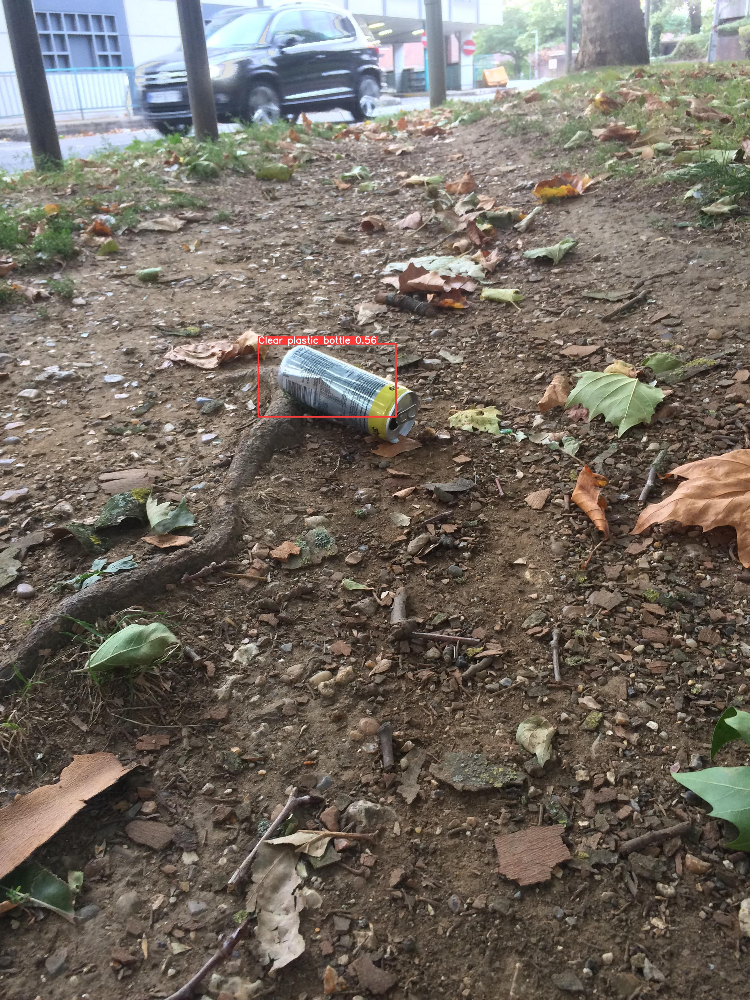

In [41]:
Image('/content/yolov5/runs/detect/exp4/batch_5_000017.JPG')

In [42]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 320 --conf 0.4 --source /content/yolov5/taco/test/images/

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/yolov5/taco/test/images/, data=data/coco128.yaml, imgsz=[320, 320], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-120-g3e55763 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/36 /content/yolov5/taco/test/images/batch_10_000025.jpg: 320x160 (no detections), 15.7ms
image 2/36 /content/yolov5/taco/test/images/batch_12_000021.jpg: 320x192 (no detections), 16.5ms
image 3/36 /content/yolov5/taco/test/images/batch_13_000027.jpg: 320x256 (no detections), 13.5ms
image 4/36 /content/yol

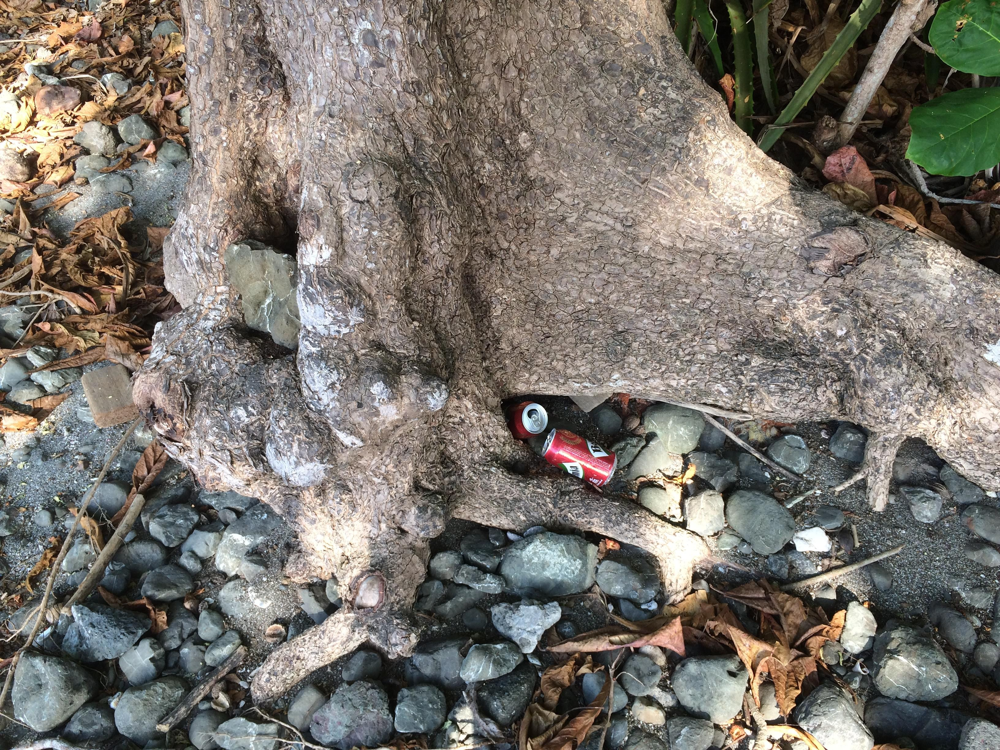

In [43]:
Image('/content/yolov5/runs/detect/exp5/batch_7_000114.JPG')

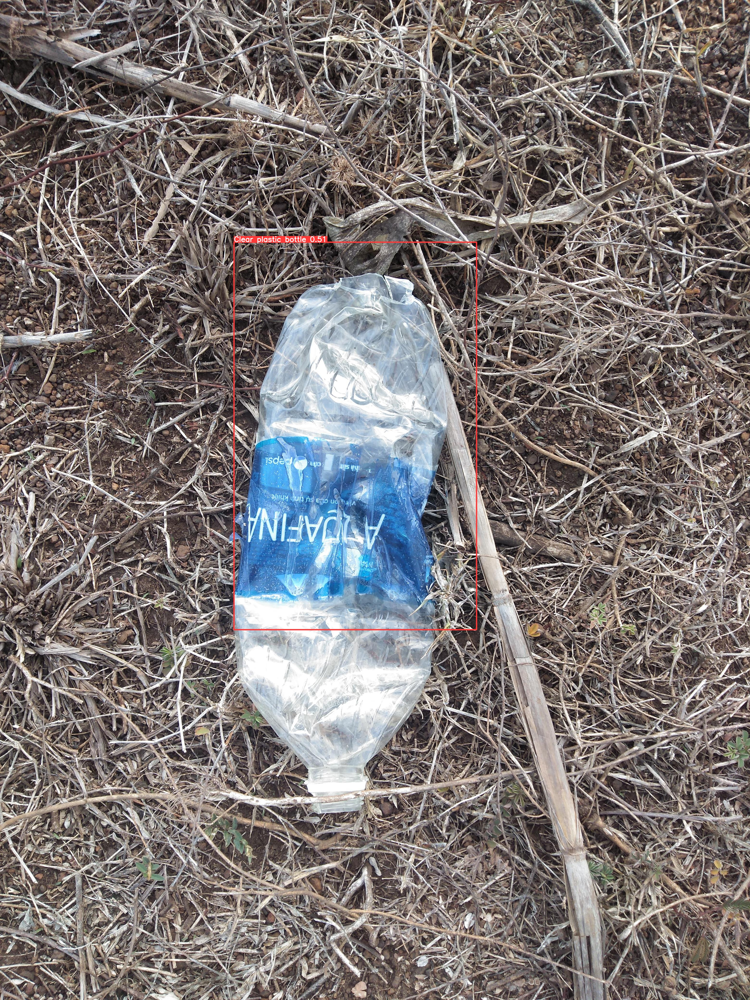

In [47]:
#Image('/content/yolov5/runs/detect/exp5/batch_8_000009.JPG') # 인식이 잘 안됐다..
Image('/content/yolov5/runs/detect/exp5/batch_13_000042.jpg')

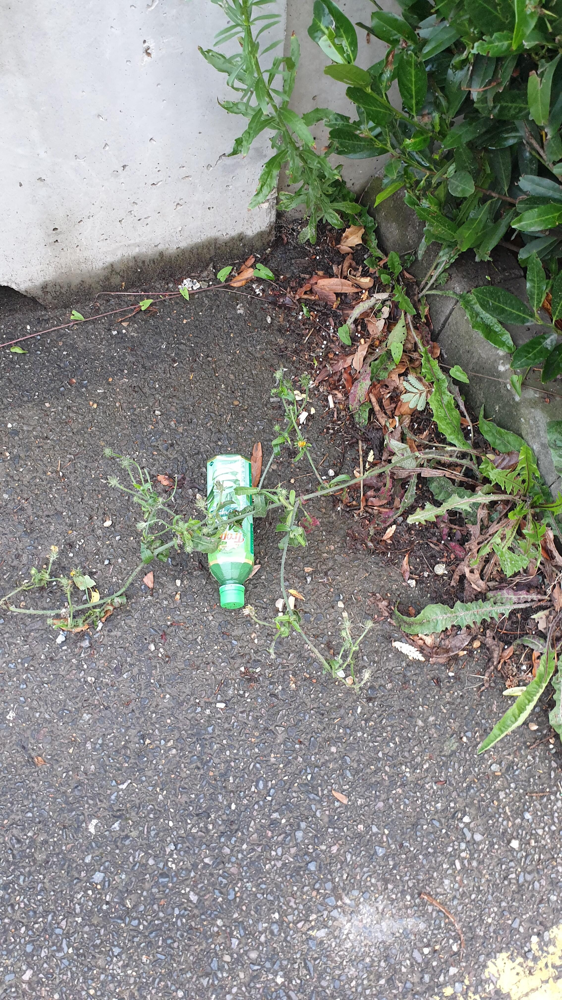

In [50]:
#Image('/content/yolov5/runs/detect/exp5/batch_8_000027.jpg')
#Image('/content/yolov5/runs/detect/exp5/batch_8_000069.jpg')
Image('/content/yolov5/runs/detect/exp5/batch_8_000085.jpg')